In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import jinja2
from dataprep.eda import create_report, plot, plot_correlation, plot_missing , plot_diff
from sklearn.metrics import confusion_matrix, precision_score, recall_score
from sklearn.linear_model import LinearRegression, LogisticRegression

In [2]:
df = pd.read_csv('train.csv')
df.head()

,PassengerId,HomePlanet,CryoSleep,Cabin,Destination,Age,VIP,RoomService,FoodCourt,ShoppingMall,Spa,VRDeck,Name,Transported
0,0001_01,Europa,False,B/0/P,TRAPPIST-1e,39.0,False,0.0,0.0,0.0,0.0,0.0,Maham Ofracculy,False
1,0002_01,Earth,False,F/0/S,TRAPPIST-1e,24.0,False,109.0,9.0,25.0,549.0,44.0,Juanna Vines,True
2,0003_01,Europa,False,A/0/S,TRAPPIST-1e,58.0,True,43.0,3576.0,0.0,6715.0,49.0,Altark Susent,False
3,0003_02,Europa,False,A/0/S,TRAPPIST-1e,33.0,False,0.0,1283.0,371.0,3329.0,193.0,Solam Susent,False
4,0004_01,Earth,False,F/1/S,TRAPPIST-1e,16.0,False,303.0,70.0,151.0,565.0,2.0,Willy Santantines,True


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8693 entries, 0 to 8692
Data columns (total 14 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   PassengerId   8693 non-null   object 
 1   HomePlanet    8492 non-null   object 
 2   CryoSleep     8476 non-null   object 
 3   Cabin         8494 non-null   object 
 4   Destination   8511 non-null   object 
 5   Age           8514 non-null   float64
 6   VIP           8490 non-null   object 
 7   RoomService   8512 non-null   float64
 8   FoodCourt     8510 non-null   float64
 9   ShoppingMall  8485 non-null   float64
 10  Spa           8510 non-null   float64
 11  VRDeck        8505 non-null   float64
 12  Name          8493 non-null   object 
 13  Transported   8693 non-null   bool   
dtypes: bool(1), float64(6), object(7)
memory usage: 891.5+ KB


  0%|          | 0/1901 [00:00<?, ?it/s]

c:\Users\shara\AppData\Local\Programs\Python\Python310\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
c:\Users\shara\AppData\Local\Programs\Python\Python310\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
c:\Users\shara\AppData\Local\Programs\Python\Python310\lib\site-packages\dataprep\eda\distribution\render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({col: [nrows - npresent]}, index=["Others"]))
c:\Users\shara\AppData\Local\Programs\Python\Python310\lib\site-packages\dataprep\eda\distribution\render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({c


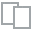
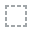
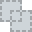
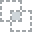
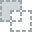
...
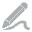
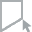
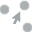
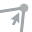
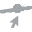

In [4]:
report = create_report(df)
report.show()


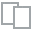
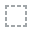
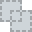
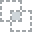
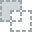
...
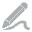
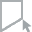
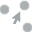
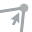
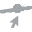

In [5]:
plot_correlation(df)

In [6]:
df.isnull().sum()

PassengerId       0
HomePlanet      201
CryoSleep       217
Cabin           199
Destination     182
Age             179
VIP             203
RoomService     181
FoodCourt       183
ShoppingMall    208
Spa             183
VRDeck          188
Name            200
Transported       0
dtype: int64

Feature Engineering - borrowed

In [7]:
expense_features = ['RoomService', 'FoodCourt', 'ShoppingMall', 'Spa', 'VRDeck']

In [8]:
def age_group(df):
    age_group = pd.cut(x=df.Age.astype(float),
                      bins=[-1, 12, 18, 25, 30, 50, 1.e+10],
                      labels=['Age_0-12', 'Age_13-17', 'Age_18-25', 'Age_26-30', 'Age_31-50', 'Age_51+'])
    if 'Age_Group' in df.columns:
        df = df.drop('Age_Group', axis=1)
        df.insert(df.shape[1],'Age_Group', age_group)
    else:
        df.insert(df.shape[1],'Age_Group', age_group)
    return df


def expense(df):
    df['Total_expense'] = df.loc[:,expense_features].sum(axis=1)
    df['No_expenses'] = (df['Total_expense']==0).astype(int)
    return df


def passengerid_extracting_data(df):
    df.loc[:,['GroupId']] = df.PassengerId.str.split("_",expand=True).iloc[:,0]
    df.loc[:,['MemberId']] = df.PassengerId.str.split("_",expand=True).iloc[:,1]
    return df


def group_size(df):
    df['Group_size']=df['GroupId'].map(lambda x: df['GroupId'].value_counts()[x])
    df['Solo']=(df['Group_size']==1).astype(int)
    return df


def cabin_extracting_data(df):
    df.loc[:,['Deck']] = df.Cabin.str.split("/",expand=True).iloc[:,0]
    df.loc[:,['Num']] = df.Cabin.str.split("/",expand=True).iloc[:,1]
    df.Num = df.Num.str.strip()
    df.Num = df.Num.astype('float').astype('Int64')
    df.loc[:,['Side']] = df.Cabin.str.split("/",expand=True).iloc[:,2]
    return df


def cabin_region(df):
    cabin_group = pd.cut(x=df.Num.astype('float'),
                      bins=[-10, 300, 600, 900, 1200, 1500, 1800, 1.e+10],
                      labels=['Cab_r_1', 'Cab_r_2', 'Cab_r_3', 'Cab_r_4', 'Cab_r_5', 'Cab_r_6', 'Cab_r_7'])
    if 'Cabin_Region' in df.columns:
        df = df.drop('Cabin_Region', axis=1)
        df.insert(df.shape[1],'Cabin_Region', cabin_group)
    else:
        df.insert(df.shape[1],'Cabin_Region', cabin_group)
    return df


def surname(df):
    df['Name'].fillna('Unknown Unknown', inplace=True)
    df['Surname'] = df['Name'].str.split(expand=True)[1]
    return df


def family_size(df):
    df['Family_size']=df['Surname'].map(lambda x: df['Surname'].value_counts()[x])
    return df

# def family_size(df):
#     df['Family_size'] = df.groupby(['GroupId', 'Surname', 'HomePlanet'])['PassengerId'].transform('size')
#     return df

In [9]:
df = age_group(df)
df = expense(df)
df = passengerid_extracting_data(df)
df = group_size(df)
df = cabin_extracting_data(df)
df = cabin_region(df)
df = surname(df)
df = family_size(df)

In [10]:
df.Family_size.value_counts()

5      1280
4      1280
3      1164
6      1038
7       833
2       800
8       544
1       382
9       315
10      300
11      275
200     200
12       84
13       78
14       56
15       30
18       18
16       16
Name: Family_size, dtype: int64

In [11]:
def hp_groupid(df):
    GHP_gb=df.groupby(['GroupId','HomePlanet'])['HomePlanet'].size().unstack().fillna(0)
    ghp_index=df[df['HomePlanet'].isna()][(df[df['HomePlanet'].isna()]['GroupId']).isin(GHP_gb.index)].index
    df.loc[ghp_index,'HomePlanet']=df.iloc[ghp_index,:]['GroupId'].map(lambda x: GHP_gb.idxmax(axis=1)[x])
    return df


def hp_deck(df):
    CDHP_gb=df.groupby(['Deck','HomePlanet'])['HomePlanet'].size().unstack().fillna(0)
    df.loc[(df['HomePlanet'].isna()) & (df['Deck'].isin(['A', 'B', 'C', 'T'])), 'HomePlanet']='Europa'
    df.loc[(df['HomePlanet'].isna()) & (df['Deck']=='G'), 'HomePlanet']='Earth'
    return df


def hp_surname(df):
    SHP_gb=df.groupby(['Surname','HomePlanet'])['HomePlanet'].size().unstack().fillna(0)
    SHP_index=df[df['HomePlanet'].isna()][(df[df['HomePlanet'].isna()]['Surname']).isin(SHP_gb.index)].index
    df.loc[SHP_index,'HomePlanet']=df.iloc[SHP_index,:]['Surname'].map(lambda x: SHP_gb.idxmax(axis=1)[x])
    return df


def hp_destination(df):
    HPD_gb=df.groupby(['HomePlanet','Destination'])['Destination'].size().unstack().fillna(0)
    df.loc[(df['HomePlanet'].isna()) & ~(df['Deck']=='D'), 'HomePlanet']='Earth'
    df.loc[(df['HomePlanet'].isna()) & (df['Deck']=='D'), 'HomePlanet']='Mars'
    return df


def destination(df):
    df.loc[(df['Destination'].isna()), 'Destination']='TRAPPIST-1e'
    return df


def surname_groupid(df):
    GSN_gb=df[df['Group_size']>1].groupby(['GroupId','Surname'])['Surname'].size().unstack().fillna(0)
    GSN_index=df[df['Surname'].isna()][(df[df['Surname'].isna()]['GroupId']).isin(GSN_gb.index)].index
    df.loc[GSN_index,'Surname']=df.iloc[GSN_index,:]['GroupId'].map(lambda x: GSN_gb.idxmax(axis=1)[x])
    return df


def surname_na(df):
    df['Surname'].fillna('Unknown', inplace=True)
    df['Family_size']=df['Surname'].map(lambda x: df['Surname'].value_counts()[x])
    df.loc[df['Surname']=='Unknown','Surname']=np.nan
    df.loc[df['Family_size']>100,'Family_size']=0
    return df


def cabin_side_groupid(df):
    GCD_gb=df[df['Group_size']>1].groupby(['GroupId','Deck'])['Deck'].size().unstack().fillna(0)
    GCN_gb=df[df['Group_size']>1].groupby(['GroupId','Num'])['Num'].size().unstack().fillna(0)
    GCS_gb=df[df['Group_size']>1].groupby(['GroupId','Side'])['Side'].size().unstack().fillna(0)
    GCS_index=df[df['Side'].isna()][(df[df['Side'].isna()]['GroupId']).isin(GCS_gb.index)].index
    df.loc[GCS_index,'Side']=df.iloc[GCS_index,:]['GroupId'].map(lambda x: GCS_gb.idxmax(axis=1)[x])
    return df


def cabin_side_surname(df):
    SCS_gb=df[df['Group_size']>1].groupby(['Surname','Side'])['Side'].size().unstack().fillna(0)
    SCS_gb['Ratio']=SCS_gb['P']/(SCS_gb['P']+SCS_gb['S'])
    SCS_gb.drop('Ratio', axis=1, inplace=True)
    SCS_index=df[df['Side'].isna()][(df[df['Side'].isna()]['Surname']).isin(SCS_gb.index)].index
    df.loc[SCS_index,'Side']=df.iloc[SCS_index,:]['Surname'].map(lambda x: SCS_gb.idxmax(axis=1)[x])
    return df


def cabin_side(df):
    df.loc[df['Side'].isna(),'Side']='Z'
    return df


def deck_groupid(df):
    GCD_gb=df[df['Group_size']>1].groupby(['GroupId','Deck'])['Deck'].size().unstack().fillna(0)
    GCD_index=df[df['Deck'].isna()][(df[df['Deck'].isna()]['GroupId']).isin(GCD_gb.index)].index
    df.loc[GCD_index,'Deck']=df.iloc[GCD_index,:]['GroupId'].map(lambda x: GCD_gb.idxmax(axis=1)[x])
    return df


def deck_other(df):
    CD_bef=df['Deck'].isna().sum()
    na_rows_CD=df.loc[df['Deck'].isna(),'Deck'].index
    df.loc[df['Deck'].isna(),'Deck']=df.groupby(['HomePlanet','Destination','Solo'])['Deck'].transform(lambda x: x.fillna(pd.Series.mode(x)[0]))[na_rows_CD]
    return df


def num_linear(df):
    preds_CN_all = []
    for deck in ['A', 'B', 'C', 'D', 'E', 'F', 'G']:
        # Features and labels
        X_CN=df.loc[~(df['Num'].isna()) & (df['Deck']==deck),'GroupId']
        y_CN=df.loc[~(df['Num'].isna()) & (df['Deck']==deck),'Num']
        X_test_CN=df.loc[(df['Num'].isna()) & (df['Deck']==deck),'GroupId']

        # Linear regression
        model_CN=LinearRegression()
        model_CN.fit(X_CN.values.reshape(-1, 1), y_CN)
        preds_CN=model_CN.predict(X_test_CN.values.reshape(-1, 1))

        # Fill missing values with predictions
        df.loc[(df['Num'].isna()) & (df['Deck']==deck),'Num']=preds_CN.astype(int)
    return df


def vip(df):
    df.loc[df['VIP'].isna(),'VIP']=False
    return df


def age(df):
    na_rows_A=df.loc[df['Age'].isna(),'Age'].index
    df.loc[df['Age'].isna(),'Age']=df.groupby(['HomePlanet','No_expenses','Solo','Deck'])['Age'].transform(lambda x: x.fillna(x.median()))[na_rows_A]
    return df


def cryosleep(df):
    na_rows_CSL=df.loc[df['CryoSleep'].isna(),'CryoSleep'].index
    df.loc[df['CryoSleep'].isna(),'CryoSleep']=df.groupby(['No_expenses'])['CryoSleep'].transform(lambda x: x.fillna(pd.Series.mode(x)[0]))[na_rows_CSL]
    return df


def expense_features_na(df):
    for col in expense_features:
        df.loc[(df[col].isna()) & (df['CryoSleep']==True), col]=0
    for col in expense_features:
        na_rows=df.loc[df[col].isna(),col].index
        df.loc[df[col].isna(),col]=df.groupby(['HomePlanet','Solo','Age_Group'])[col].transform(lambda x: x.fillna(x.mean()))[na_rows]
    return df

In [12]:
df = hp_groupid(df)
df = hp_deck(df)
df = hp_surname(df)
df = hp_destination(df)
df = destination(df)
df = surname_groupid(df)
df = surname_na(df)
df = cabin_side_groupid(df)
df = cabin_side_surname(df)
df = cabin_side(df)
df = deck_groupid(df)
df = deck_other(df)
df = num_linear(df)
df = cabin_region(df)
df = vip(df)
df = age(df)
df = age_group(df)
df = cryosleep(df)
df = expense_features_na(df)
df = expense(df)

In [13]:
df.isnull().sum()

PassengerId        0
HomePlanet         0
CryoSleep          0
Cabin            199
Destination        0
Age                0
VIP                0
RoomService        0
FoodCourt          0
ShoppingMall       0
Spa                0
VRDeck             0
Name               0
Transported        0
Total_expense      0
No_expenses        0
GroupId            0
MemberId           0
Group_size         0
Solo               0
Deck               0
Num                0
Side               0
Surname          200
Family_size        0
Cabin_Region       0
Age_Group          0
dtype: int64

In [14]:
numerical_cols = ['RoomService', 'FoodCourt', 'ShoppingMall', 'Spa', 'VRDeck', 'Total_expense', 'No_expenses', 'Solo', 'Family_size']
categorical_cols = ['HomePlanet', 'CryoSleep', 'Destination', 'VIP', 'Deck', 'Side', 'Cabin_Region']
target_col = 'Transported'

In [15]:
print("Before Dropping: ",df.shape)
# create a set of all columns in the dataset
all_cols = set(df.columns)

# create a set of columns to keep
keep_cols = set(numerical_cols + categorical_cols + [target_col])

# create a set of columns to drop
drop_cols = all_cols - keep_cols

# drop the columns not in the keep_cols set
df = df.drop(columns=drop_cols)
print("After Dropping: ",df.shape)

Before Dropping:  (8693, 27)
After Dropping:  (8693, 17)


In [16]:
df.head()

,HomePlanet,CryoSleep,Destination,VIP,RoomService,FoodCourt,ShoppingMall,Spa,VRDeck,Transported,Total_expense,No_expenses,Solo,Deck,Side,Family_size,Cabin_Region
0,Europa,False,TRAPPIST-1e,False,0.0,0.0,0.0,0.0,0.0,False,0.0,1,1,B,P,1,Cab_r_1
1,Earth,False,TRAPPIST-1e,False,109.0,9.0,25.0,549.0,44.0,True,736.0,0,1,F,S,4,Cab_r_1
2,Europa,False,TRAPPIST-1e,True,43.0,3576.0,0.0,6715.0,49.0,False,10383.0,0,0,A,S,6,Cab_r_1
3,Europa,False,TRAPPIST-1e,False,0.0,1283.0,371.0,3329.0,193.0,False,5176.0,0,0,A,S,6,Cab_r_1
4,Earth,False,TRAPPIST-1e,False,303.0,70.0,151.0,565.0,2.0,True,1091.0,0,1,F,S,6,Cab_r_1


In [17]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8693 entries, 0 to 8692
Data columns (total 17 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   HomePlanet     8693 non-null   object  
 1   CryoSleep      8693 non-null   object  
 2   Destination    8693 non-null   object  
 3   VIP            8693 non-null   object  
 4   RoomService    8693 non-null   float64 
 5   FoodCourt      8693 non-null   float64 
 6   ShoppingMall   8693 non-null   float64 
 7   Spa            8693 non-null   float64 
 8   VRDeck         8693 non-null   float64 
 9   Transported    8693 non-null   bool    
 10  Total_expense  8693 non-null   float64 
 11  No_expenses    8693 non-null   int32   
 12  Solo           8693 non-null   int32   
 13  Deck           8693 non-null   object  
 14  Side           8693 non-null   object  
 15  Family_size    8693 non-null   int64   
 16  Cabin_Region   8693 non-null   category
dtypes: bool(1), category(1), float64(

In [18]:
df.CryoSleep.value_counts()

False    5492
True     3103
False      66
True       32
Name: CryoSleep, dtype: int64

In [19]:
df['CryoSleep'] = df['CryoSleep'].replace({'True': True, 'False': False})
df['CryoSleep'].value_counts()

False    5558
True     3135
Name: CryoSleep, dtype: int64

In [20]:
df.VIP.value_counts()

False    8396
True      198
False      98
True        1
Name: VIP, dtype: int64

In [21]:
df['VIP'] = df['VIP'].replace({'True': True, 'False': False})
df['VIP'].value_counts()

False    8494
True      199
Name: VIP, dtype: int64

In [22]:
for col in categorical_cols:
    print(df[col].value_counts())

Earth     4715
Europa    2174
Mars      1804
Name: HomePlanet, dtype: int64
False    5558
True     3135
Name: CryoSleep, dtype: int64
TRAPPIST-1e      6097
55 Cancri e      1800
PSO J318.5-22     796
Name: Destination, dtype: int64
False    8494
True      199
Name: VIP, dtype: int64
F    2838
G    2638
E     885
B     796
C     782
D     487
A     262
T       5
Name: Deck, dtype: int64
S    4369
P    4272
Z      52
Name: Side, dtype: int64
Cab_r_1    3663
Cab_r_2    1517
Cab_r_3    1006
Cab_r_4    1005
Cab_r_5     958
Cab_r_6     466
Cab_r_7      78
Name: Cabin_Region, dtype: int64


In [23]:
df1 = pd.get_dummies(data = df, columns=categorical_cols,drop_first=True)
df.shape, df1.shape

((8693, 17), (8693, 31))

Modeling

In [24]:
X = df1.drop(target_col,axis=1)
y = df1[target_col]
X.shape, y.shape

((8693, 30), (8693,))

In [25]:
y.value_counts()

True     4378
False    4315
Name: Transported, dtype: int64

In [26]:
# create X and Y datasets for training
from sklearn import model_selection
X_train, X_test, y_train, y_test = model_selection.train_test_split(X, y,stratify=y, random_state=42, test_size = 0.2)

X_train.shape, X_test.shape, y_train.shape, y_test.shape

((6954, 30), (1739, 30), (6954,), (1739,))

Logreg

In [27]:
from sklearn.linear_model import LogisticRegression


# instantiate the model
logreg = LogisticRegression(solver='liblinear', random_state=0)


# fit the model
logreg.fit(X_train, y_train)

LogisticRegression(random_state=0, solver='liblinear')

In [28]:
print('Training set score: {:.4f}'.format(logreg.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(logreg.score(X_test, y_test)))

Training set score: 0.7961
Test set score: 0.8051


In [29]:
y_pred = logreg.predict(X_test)

In [30]:
from sklearn.metrics import log_loss
log_log = log_loss(y_test, y_pred)
print(log_log)

6.733061485334525


In [31]:
log_accuracy = logreg.score(X_test, y_test)
log_accuracy

0.8050603795284647

In [32]:
# precision
log_pre = precision_score(y_test, y_pred)
log_pre

0.7953795379537953

In [33]:
# recall
log_rec = recall_score(y_test, y_pred)
log_rec

0.8253424657534246

In [34]:
from sklearn.model_selection import GridSearchCV

from sklearn.neighbors import KNeighborsClassifier
#In case of classifier like knn the parameter to be tuned is n_neighbors
param_grid = {'n_neighbors':np.arange(1,50)}
knn = KNeighborsClassifier()
knn_cv= GridSearchCV(knn,param_grid,verbose=10,cv=3)
knn_cv.fit(X_train,y_train)

print("Best Score:" + str(knn_cv.best_score_))
print("Best Parameters: " + str(knn_cv.best_params_))

Fitting 3 folds for each of 49 candidates, totalling 147 fits
[CV 1/3; 1/49] START n_neighbors=1..............................................
[CV 1/3; 1/49] END ...............n_neighbors=1;, score=0.732 total time=   0.0s
[CV 2/3; 1/49] START n_neighbors=1..............................................
[CV 2/3; 1/49] END ...............n_neighbors=1;, score=0.732 total time=   0.0s
[CV 3/3; 1/49] START n_neighbors=1..............................................
[CV 3/3; 1/49] END ...............n_neighbors=1;, score=0.728 total time=   0.0s
[CV 1/3; 2/49] START n_neighbors=2..............................................
[CV 1/3; 2/49] END ...............n_neighbors=2;, score=0.748 total time=   0.0s
[CV 2/3; 2/49] START n_neighbors=2..............................................
[CV 2/3; 2/49] END ...............n_neighbors=2;, score=0.739 total time=   0.0s
[CV 3/3; 2/49] START n_neighbors=2..............................................
[CV 3/3; 2/49] END ...............n_neighbors=2

In [35]:
print('Training set score: {:.4f}'.format(knn_cv.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(knn_cv.score(X_test, y_test)))

Training set score: 0.8057
Test set score: 0.7993


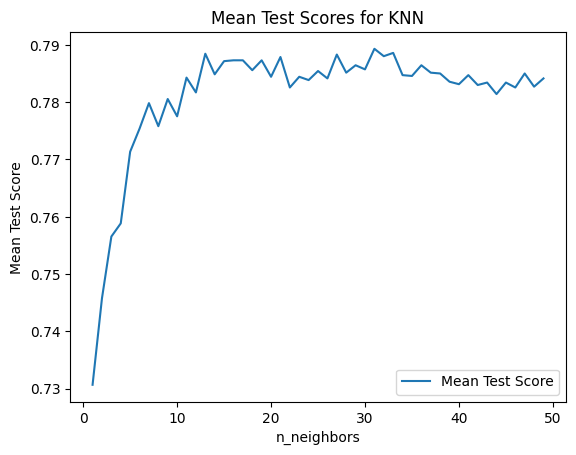

In [36]:
import matplotlib.pyplot as plt

# Plot the mean test scores for each value of n_neighbors
plt.plot(np.arange(1,50), knn_cv.cv_results_['mean_test_score'], label='Mean Test Score')

# Add a legend to the plot
plt.legend()
plt.title('Mean Test Scores for KNN')
plt.xlabel('n_neighbors')
plt.ylabel('Mean Test Score')
plt.show()

In [37]:
knn_log = log_loss(y_test, y_pred)
print(knn_log)

6.733061485334525


In [38]:
knn_accuracy = knn_cv.score(X_test, y_test)
knn_accuracy

0.7993099482461185

In [39]:
# precision
knn_pre = precision_score(y_test, y_pred)
knn_pre

0.7953795379537953

In [40]:
# recall
knn_rec = recall_score(y_test, y_pred)
knn_rec

0.8253424657534246

Random Forests

In [128]:
# import Random Forest classifier
from sklearn.ensemble import RandomForestClassifier

# instantiate the classifier 
rfc_100 = RandomForestClassifier(random_state=12,n_estimators=1000)

# fit the model
rfc_100.fit(X_train, y_train)

# Predict the Test set results
y_pred = rfc_100.predict(X_test)

# Check accuracy score 
from sklearn.metrics import accuracy_score

print('Model accuracy score with 100 decision-trees : {0:0.4f}'. format(accuracy_score(y_test, y_pred)))

Model accuracy score with 100 decision-trees : 0.8056


In [129]:
print('Training set score: {:.4f}'.format(rfc_100.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(rfc_100.score(X_test, y_test)))

Training set score: 0.9548
Test set score: 0.8056


In [130]:
from sklearn.metrics import log_loss
rfcv_log = log_loss(y_test, y_pred)
print(rfcv_log)

6.713173070933553


In [43]:
rfcv_accuracy = rfc_100.score(X_test, y_test)
rfcv_accuracy

0.8056354226566993

In [44]:
# precision
rfcv_pre = precision_score(y_test, y_pred)
rfcv_pre

0.8396464646464646

In [45]:
# recall
rfcv_rec = recall_score(y_test, y_pred)
rfcv_rec

0.7591324200913242

In [46]:
def plot_feature_importance(importance,names,model_type):

    #Create arrays from feature importance and feature names
    feature_importance = np.array(importance)
    feature_names = np.array(names)

    #Create a DataFrame using a Dictionary
    data={'feature_names':feature_names,'feature_importance':feature_importance}
    fi_df = pd.DataFrame(data)

    #Sort the DataFrame in order decreasing feature importance
    fi_df.sort_values(by=['feature_importance'], ascending=False,inplace=True)

    #Define size of bar plot
    plt.figure(figsize=(10,8))
    #Plot Searborn bar chart
    sns.barplot(x=fi_df['feature_importance'], y=fi_df['feature_names'])

    # Only top 10
    # sns.barplot(x=fi_df['feature_importance'][:10], y=fi_df['feature_names'][:10])

    #Add chart labels
    plt.title(model_type + 'FEATURE IMPORTANCE')
    plt.xlabel('FEATURE IMPORTANCE')
    plt.ylabel('FEATURE NAMES')

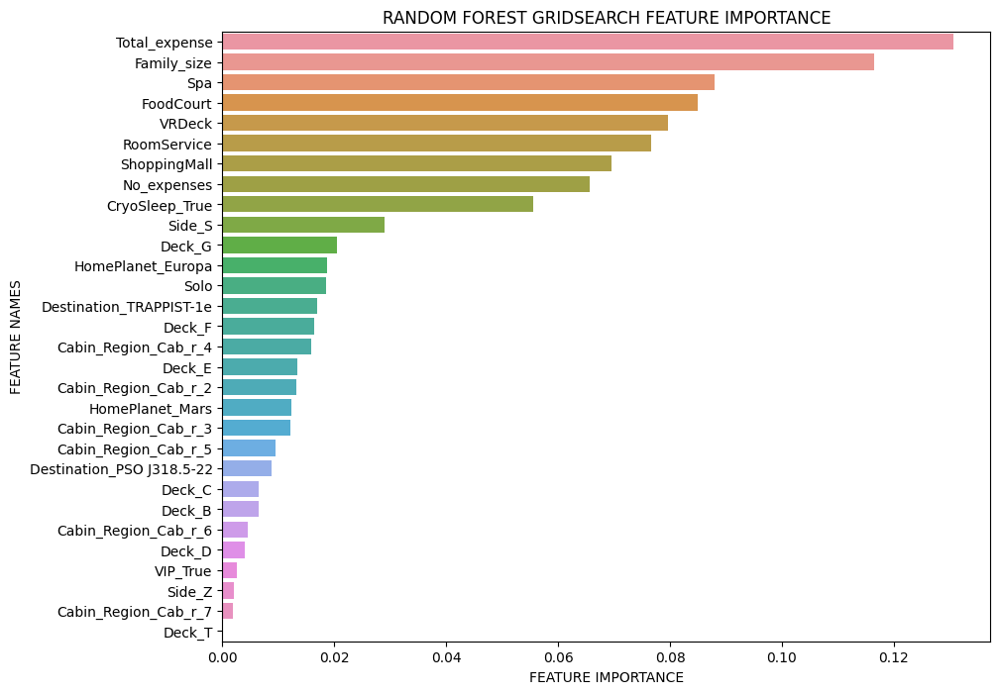

In [47]:
plot_feature_importance(rfc_100.feature_importances_,X_train.columns,'RANDOM FOREST GRIDSEARCH ')

ANN

In [98]:
from sklearn.preprocessing import LabelEncoder, StandardScaler, MinMaxScaler
from sklearn.pipeline import Pipeline
# Importing libraries for building the neural network
from keras.models import Sequential
from keras.layers import Dense, Dropout, Flatten
from keras.wrappers.scikit_learn import KerasClassifier
from sklearn.model_selection import StratifiedKFold, cross_val_score, KFold, train_test_split
from keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau, TensorBoard
from keras.optimizers import SGD, Adam, Adadelta, RMSprop
from keras.callbacks import EarlyStopping
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
import tensorflow as tf

In [100]:
spaceship_model = Sequential()
spaceship_model.add(Dense(256, input_shape = (X_train.shape[1],), activation = "relu"))
spaceship_model.add(Dense(512, activation = "relu"))
spaceship_model.add(Dense(1024, activation = "relu"))
spaceship_model.add(Dropout(0.2))
spaceship_model.add(Dense(1024, activation = "relu"))
spaceship_model.add(Dense(512, activation = "relu"))
spaceship_model.add(Dense(256, activation = "relu"))
spaceship_model.add(Flatten())
spaceship_model.add(Dense(512, activation = "relu"))
spaceship_model.add(Dropout(0.5))
spaceship_model.add(Dense(512, activation = "relu"))
spaceship_model.add(Dropout(0.5))
# spaceship_model.add(Dense(1, activation = "sigmoid",kernel_regularizer = "binary_crossentropy"))
spaceship_model.add(Dense(1, activation = "sigmoid"))
spaceship_model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 256)               7936      
                                                                 
 dense_1 (Dense)             (None, 512)               131584    
                                                                 
 dense_2 (Dense)             (None, 1024)              525312    
                                                                 
 dropout (Dropout)           (None, 1024)              0         
                                                                 
 dense_3 (Dense)             (None, 1024)              1049600   
                                                                 
 dense_4 (Dense)             (None, 512)               524800    
                                                                 
 dense_5 (Dense)             (None, 256)              

In [102]:
optimizer=Adam(learning_rate=0.001, beta_1=0.9, beta_2=0.999)
losses = tf.keras.losses.binary_crossentropy
spaceship_model.compile(optimizer=optimizer, loss=losses, metrics=['accuracy'])

In [103]:
m_loss = EarlyStopping(
    monitor="val_accuracy",
    min_delta=0,
    patience=15,
    verbose=1,
    mode="auto",
    baseline=None,
    restore_best_weights=True,
)

In [104]:
save_checkpoint = tf.keras.callbacks.ModelCheckpoint(filepath='spaceship_model.h5', monitor='val_accuracy', save_best_only=True, verbose=1)

In [106]:
history=spaceship_model.fit(X_train, y_train,validation_data=(X_test, y_test), epochs=100, batch_size=128, verbose=1,callbacks=[m_loss,save_checkpoint])

Epoch 1/100
48/55 [=========================>....] - ETA: 0s - loss: 2.8441 - accuracy: 0.7186
Epoch 1: val_accuracy improved from -inf to 0.79298, saving model to spaceship_model.h5
55/55 [==============================] - 3s 11ms/step - loss: 2.5789 - accuracy: 0.7262 - val_loss: 0.4964 - val_accuracy: 0.7930
Epoch 2/100
51/55 [==========================>...] - ETA: 0s - loss: 0.4959 - accuracy: 0.7719
Epoch 2: val_accuracy improved from 0.79298 to 0.79988, saving model to spaceship_model.h5
55/55 [==============================] - 0s 5ms/step - loss: 0.4925 - accuracy: 0.7738 - val_loss: 0.4486 - val_accuracy: 0.7999
Epoch 3/100
44/55 [=======================>......] - ETA: 0s - loss: 0.4448 - accuracy: 0.7930
Epoch 3: val_accuracy improved from 0.79988 to 0.80506, saving model to spaceship_model.h5
55/55 [==============================] - 0s 6ms/step - loss: 0.4469 - accuracy: 0.7912 - val_loss: 0.4203 - val_accuracy: 0.8051
Epoch 4/100
42/55 [=====================>........] - ETA:

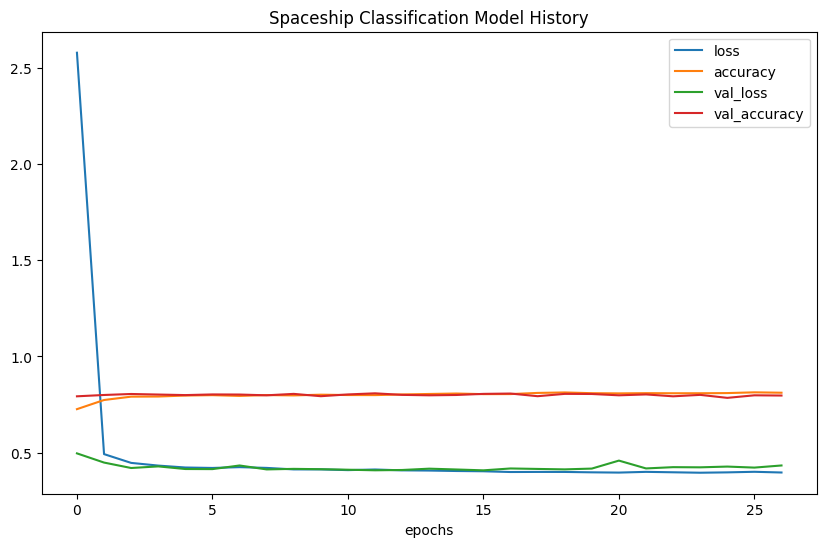

In [107]:
dfh = pd.DataFrame(history.history)
plt.figure(figsize=(10, 6))
plt.title('Spaceship Classification Model History')
plt.plot(dfh)
plt.xlabel('epochs')
plt.legend(dfh.columns)
plt.show()

In [108]:
print("Evaluate spaceship_model against trained data")
score = spaceship_model.evaluate(X_train, y_train, verbose=0)
print("score %s: %.2f%%" % (spaceship_model.metrics_names[1], score[1]*100))

print("Evaluate spaceship_model against test data")
score = spaceship_model.evaluate(X_test, y_test, verbose=0)
print("score %s: %.2f%%" % (spaceship_model.metrics_names[1], score[1]*100))

Evaluate spaceship_model against trained data
score accuracy: 80.86%
Evaluate spaceship_model against test data
score accuracy: 80.85%


In [109]:
y_pred = spaceship_model.predict(X_test)

55/55 [==============================] - 0s 4ms/step


In [110]:
# extract the predicted probabilities
p_pred = spaceship_model.predict(X_test)
p_pred = p_pred.flatten()
print(p_pred.round(2))

55/55 [==============================] - 0s 3ms/step
[0.98 0.59 0.14 ... 0.97 0.29 0.26]


In [111]:
y_pred = np.where(p_pred > 0.5, 1, 0)
print(y_pred)

[1 1 0 ... 1 0 0]


In [112]:
cm = confusion_matrix(y_test, y_pred)
cm

array([[681, 182],
       [151, 725]], dtype=int64)

In [116]:
cm[1][0]

151

In [117]:
cnn_accuracy = (cm[0][0]+cm[1][1])/(cm[0][0]+cm[1][1]+cm[0][1]+cm[1][0])
cnn_accuracy

0.8085106382978723

In [118]:
# precision
cnn_pre = precision_score(y_test, y_pred)
cnn_pre

0.7993384785005513

In [119]:
# recall
cnn_rec = recall_score(y_test, y_pred)
cnn_rec

0.8276255707762558

In [120]:
from sklearn.metrics import log_loss
cnn_log = log_loss(y_test, y_pred)
print(cnn_log)

6.6138919299813415


lgbm

In [48]:
import lightgbm as lgb
lgbm_clf = lgb.LGBMClassifier()
lgbm_clf.fit(X_train, y_train)

LGBMClassifier()

In [49]:
#print the scores on training and test set

print('Training set score: {:.4f}'.format(lgbm_clf.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(lgbm_clf.score(X_test, y_test)))

Training set score: 0.8740
Test set score: 0.8108


In [50]:
lgbm_clf.get_params()

{'boosting_type': 'gbdt',
 'class_weight': None,
 'colsample_bytree': 1.0,
 'importance_type': 'split',
 'learning_rate': 0.1,
 'max_depth': -1,
 'min_child_samples': 20,
 'min_child_weight': 0.001,
 'min_split_gain': 0.0,
 'n_estimators': 100,
 'n_jobs': -1,
 'num_leaves': 31,
 'objective': None,
 'random_state': None,
 'reg_alpha': 0.0,
 'reg_lambda': 0.0,
 'silent': 'warn',
 'subsample': 1.0,
 'subsample_for_bin': 200000,
 'subsample_freq': 0}

Hyperparameter tuning

In [125]:
from optuna.integration import LightGBMPruningCallback
import optuna
from sklearn.metrics import log_loss
from sklearn.model_selection import StratifiedKFold
import lightgbm as lgbm

def objective(trial, X, y):
    param_grid = {
        "device_type": trial.suggest_categorical("device_type", ['gpu']),
        "learning_rate": trial.suggest_float("learning_rate", 0.001, 0.3),
        "num_leaves": trial.suggest_int("num_leaves", 20, 3000),
        "n_estimators": trial.suggest_int("n_estimators", 100, 1000, step=50),
        "max_depth": trial.suggest_int("max_depth", 3, 12),
        "min_child_samples": trial.suggest_int("min_child_samples",20,200),
        "subsample": trial.suggest_float("subsample",0.5,1.0),
        "colsample_bytree": trial.suggest_float("colsample_bytree",0.5,1.0),
    }

    cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=1121218)

    cv_scores = np.empty(5)
    for idx, (train_idx, test_idx) in enumerate(cv.split(X, y)):
        X_train, X_test = X.iloc[train_idx], X.iloc[test_idx]
        y_train, y_test = y[train_idx], y[test_idx]

        model = lgbm.LGBMClassifier(objective="binary", **param_grid)
        model.fit(
            X_train,
            y_train,
            eval_set=[(X_test, y_test)],
            eval_metric="binary_logloss",
            early_stopping_rounds=100,
            callbacks=[
                LightGBMPruningCallback(trial, "binary_logloss")
            ],  # Add a pruning callback
        )
        preds = model.predict_proba(X_test)
        cv_scores[idx] = log_loss(y_test, preds)

    return np.mean(cv_scores)

In [ ]:
study = optuna.create_study(direction="maximize", study_name="LGBM Classifier")
func = lambda trial: objective(trial, X, y)
study.optimize(func, n_trials=500, n_jobs=4)

In [55]:
print(f"\tBest value (logloss): {study.best_value:.5f}")
print(f"\tBest params:")

for key, value in study.best_params.items():
    print(f"\t\t{key}: {value}")

	Best value (logloss): 0.38659
	Best params:
		device_type: gpu
		learning_rate: 0.03347221380665573
		num_leaves: 2581
		n_estimators: 450
		max_depth: 6
		min_child_samples: 68
		subsample: 0.8592619584363045
		colsample_bytree: 0.6549823390432779


In [ ]:
best_params_lgbm

In [60]:
best_params_lgbm = {'device_type': 'gpu',
		'learning_rate': 0.254855637879064,
		'num_leaves': 2490,
		'n_estimators': 300,
		'max_depth': 9,
		'min_child_samples': 128,
		'subsample': 0.5598206772110758,
		'colsample_bytree': 0.669266682689784}

In [57]:
best_params_lgbm = study.best_params

In [61]:
lgbm_clf = lgb.LGBMClassifier(**best_params_lgbm)
lgbm_clf.fit(X_train, y_train)

LGBMClassifier(colsample_bytree=0.669266682689784, device_type='gpu',
               learning_rate=0.254855637879064, max_depth=9,
               min_child_samples=128, n_estimators=300, num_leaves=2490,
               subsample=0.5598206772110758)

In [62]:
#print the scores on training and test set

print('Training set score: {:.4f}'.format(lgbm_clf.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(lgbm_clf.score(X_test, y_test)))

Training set score: 0.9186
Test set score: 0.8114


In [63]:
y_pred=lgbm_clf.predict(X_test)

In [64]:
lgbm_log = log_loss(y_test, y_pred)
print(lgbm_log)

6.5145735449855176


In [65]:
lgbm_accuracy = lgbm_clf.score(X_test, y_test)
lgbm_accuracy

0.8113858539390454

In [66]:
# precision
lgbm_pre = precision_score(y_test, y_pred)
lgbm_pre

0.8186046511627907

In [67]:
# recall
lgbm_rec = recall_score(y_test, y_pred)
lgbm_rec

0.8036529680365296

XGB

In [68]:
import xgboost as xgb
from sklearn.metrics import accuracy_score, roc_auc_score

# Train the base_model_xgb
base_model_xgb = xgb.XGBClassifier()
base_model_xgb.fit(X_train, y_train)

# Evaluate the base_model_xgb
y_pred = base_model_xgb.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print(accuracy)

0.8154111558366878


In [69]:
import xgboost as xgb
from sklearn.metrics import accuracy_score, roc_auc_score
# can change the range to get better results
def objective(trial):
    # Define the hyperparameters to optimize
    param = {
        'objective': 'binary:logistic',
        'eval_metric': 'logloss',
        'reg_lambda': trial.suggest_float('reg_lambda', 1e-3, 1e2, log=True),
        'learning_rate': trial.suggest_float('learning_rate', 0.001, 0.3, log=True),
        'n_estimators': trial.suggest_int('n_estimators', 50, 2000, step=50),
        'lambda': trial.suggest_float('lambda', 1e-8, 1.0),
        'alpha': trial.suggest_float('alpha', 1e-8, 1.0),
        'max_depth': trial.suggest_int('max_depth', 3, 12),
        'eta': trial.suggest_float('eta', 1e-8, 1.0),
        'gamma': trial.suggest_float('gamma', 1e-8, 1.0),
        'subsample': trial.suggest_float('subsample', 0.1, 1.0),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.1, 1.0),
        'min_child_weight': trial.suggest_int('min_child_weight', 1, 300),
        'n_jobs': 6,
        'random_state': 0,
    }

    # Split the data into training and testing sets
    X_train, X_test, y_train, y_test = model_selection.train_test_split(X, y, test_size=0.2, random_state=0)
    
    # Train the model
    model = xgb.XGBClassifier(**param)
    model.fit(X_train, y_train)

    # Evaluate the model
    y_pred = model.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)

    return accuracy


In [70]:
# Can change the number of trials to check for better results
study = optuna.create_study(direction='maximize', study_name='XGB Classifier')
study.optimize(objective, n_trials=100, n_jobs=5)

[I 2023-03-14 01:58:31,207] A new study created in memory with name: XGB Classifier
[I 2023-03-14 01:58:31,403] Trial 1 finished with value: 0.7613571017826337 and parameters: {'reg_lambda': 0.019994129124369556, 'learning_rate': 0.11392919058579759, 'n_estimators': 50, 'lambda': 0.8707267243548265, 'alpha': 0.8957837052628833, 'max_depth': 5, 'eta': 0.0923483215253158, 'gamma': 0.6109041609440943, 'subsample': 0.9338738480520391, 'colsample_bytree': 0.6578687067901131, 'min_child_weight': 272}. Best is trial 1 with value: 0.7613571017826337.
[I 2023-03-14 01:58:31,680] Trial 4 finished with value: 0.7452558941920644 and parameters: {'reg_lambda': 13.370418192770314, 'learning_rate': 0.01534855727717604, 'n_estimators': 150, 'lambda': 0.008018404849759101, 'alpha': 0.16144360709006464, 'max_depth': 9, 'eta': 0.07351770979234337, 'gamma': 0.30813909510429033, 'subsample': 0.2679710084912561, 'colsample_bytree': 0.7928110963810204, 'min_child_weight': 81}. Best is trial 1 with value: 0.7

In [71]:
print("Important parameters For XGB is")
print(optuna.importance.get_param_importances(study))

Important parameters For XGB is
OrderedDict([('min_child_weight', 0.49366975264280394), ('subsample', 0.42894136299920016), ('eta', 0.0176590097086965), ('alpha', 0.017358285725404883), ('colsample_bytree', 0.011518989514990547), ('learning_rate', 0.011186430210134162), ('lambda', 0.008188402207176704), ('max_depth', 0.004444625524328089), ('reg_lambda', 0.0034433504484736237), ('gamma', 0.0021391518924937904), ('n_estimators', 0.0014506391262975895)])


In [72]:
best_params_xgb = study.best_trial.params
print("Best Parameter For XGB is")
print(best_params_xgb)

Best Parameter For XGB is
{'reg_lambda': 0.0017320954873237975, 'learning_rate': 0.04392324261770268, 'n_estimators': 200, 'lambda': 0.43634788638457667, 'alpha': 0.16571050326262496, 'max_depth': 10, 'eta': 0.03335388359652375, 'gamma': 0.617661714493621, 'subsample': 0.7959950014183714, 'colsample_bytree': 0.755524860202405, 'min_child_weight': 20}


In [174]:
model_xgb = xgb.XGBClassifier(objective='binary:logistic', **best_params_xgb)
model_xgb.fit(X_train,y_train)

XGBClassifier(alpha=0.16571050326262496, base_score=0.5, booster='gbtree',
              callbacks=None, colsample_bylevel=1, colsample_bynode=1,
              colsample_bytree=0.755524860202405, early_stopping_rounds=None,
              enable_categorical=False, eta=0.03335388359652375,
              eval_metric=None, feature_types=None, gamma=0.617661714493621,
              gpu_id=-1, grow_policy='depthwise', importance_type=None,
              interaction_constraints='', lambda=0.43634788638457667,
              learning_rate=0.04392324261770268, max_bin=256,
              max_cat_threshold=64, max_cat_to_onehot=4, max_delta_step=0,
              max_depth=10, max_leaves=0, min_child_weight=20, missing=nan,
              monotone_constraints='()', n_estimators=200, n_jobs=0, ...)

In [157]:
#print the scores on training and test set

print('Training set score: {:.4f}'.format(model_xgb.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(model_xgb.score(X_test, y_test)))

Training set score: 0.8387
Test set score: 0.8108


In [75]:
y_pred=model_xgb.predict(X_test)

In [76]:
xgb_log = log_loss(y_test, y_pred)
print(xgb_log)

6.534438969236111


In [77]:
cm = confusion_matrix(y_test, y_pred)
cm

array([[698, 165],
       [164, 712]], dtype=int64)

In [78]:
xgb_accuracy = model_xgb.score(X_test, y_test)
xgb_accuracy

0.8108108108108109

In [79]:
# precision
xgb_pre = precision_score(y_test, y_pred)
xgb_pre

0.8118586088939567

In [80]:
# recall
xgb_rec = recall_score(y_test, y_pred)
xgb_rec

0.8127853881278538

Catboost

In [81]:
y_new_train = y_train
y_new_train = y_new_train.astype(int)

y_new_test = y_test
y_new_test = y_new_test.astype(int)

In [82]:
from catboost import CatBoostClassifier
model_cat = CatBoostClassifier()
model_cat.fit(X_train,y_new_train,eval_set=(X_test, y_new_test))

Learning rate set to 0.051161
0:	learn: 0.6674875	test: 0.6671001	best: 0.6671001 (0)	total: 149ms	remaining: 2m 28s
1:	learn: 0.6435052	test: 0.6419766	best: 0.6419766 (1)	total: 152ms	remaining: 1m 15s
2:	learn: 0.6299754	test: 0.6285243	best: 0.6285243 (2)	total: 155ms	remaining: 51.5s
3:	learn: 0.6137572	test: 0.6123768	best: 0.6123768 (3)	total: 158ms	remaining: 39.4s
4:	learn: 0.5988112	test: 0.5973697	best: 0.5973697 (4)	total: 161ms	remaining: 32.1s
5:	learn: 0.5817326	test: 0.5800692	best: 0.5800692 (5)	total: 164ms	remaining: 27.2s
6:	learn: 0.5704567	test: 0.5697318	best: 0.5697318 (6)	total: 167ms	remaining: 23.8s
7:	learn: 0.5599845	test: 0.5591426	best: 0.5591426 (7)	total: 170ms	remaining: 21.1s
8:	learn: 0.5521519	test: 0.5514291	best: 0.5514291 (8)	total: 174ms	remaining: 19.1s
9:	learn: 0.5401237	test: 0.5388698	best: 0.5388698 (9)	total: 177ms	remaining: 17.5s
10:	learn: 0.5305804	test: 0.5294238	best: 0.5294238 (10)	total: 180ms	remaining: 16.2s
11:	learn: 0.5228893

In [83]:
#print the scores on training and test set

print('Training set score: {:.4f}'.format(model_cat.score(X_train, y_new_train)))

print('Test set score: {:.4f}'.format(model_cat.score(X_test, y_new_test)))

Training set score: 0.8822
Test set score: 0.8189


In [84]:
model_cat.get_all_params()

{'nan_mode': 'Min',
 'eval_metric': 'Logloss',
 'iterations': 1000,
 'sampling_frequency': 'PerTree',
 'leaf_estimation_method': 'Newton',
 'grow_policy': 'SymmetricTree',
 'penalties_coefficient': 1,
 'boosting_type': 'Plain',
 'model_shrink_mode': 'Constant',
 'feature_border_type': 'GreedyLogSum',
 'bayesian_matrix_reg': 0.10000000149011612,
 'eval_fraction': 0,
 'force_unit_auto_pair_weights': False,
 'l2_leaf_reg': 3,
 'random_strength': 1,
 'rsm': 1,
 'boost_from_average': False,
 'model_size_reg': 0.5,
 'pool_metainfo_options': {'tags': {}},
 'subsample': 0.800000011920929,
 'use_best_model': True,
 'class_names': [0, 1],
 'random_seed': 0,
 'depth': 6,
 'posterior_sampling': False,
 'border_count': 254,
 'classes_count': 0,
 'auto_class_weights': 'None',
 'sparse_features_conflict_fraction': 0,
 'leaf_estimation_backtracking': 'AnyImprovement',
 'best_model_min_trees': 1,
 'model_shrink_rate': 0,
 'min_data_in_leaf': 1,
 'loss_function': 'Logloss',
 'learning_rate': 0.051160998

In [85]:
y_pred=model_cat.predict(X_test)

In [86]:
print(log_loss(y_test, y_pred))

6.256382344315779


hyperparams

In [87]:
from catboost import CatBoostClassifier, Pool
import sklearn
import catboost

def objective(trial):
    train_x, valid_x, train_y, valid_y = model_selection.train_test_split(X, y, test_size=0.2, random_state=0)
    train_y = train_y.astype(int)
    valid_y = valid_y.astype(int)

    
    params = {
        'loss_function': 'Logloss',
        'eval_metric': 'Accuracy',
        'learning_rate': trial.suggest_float('learning_rate', 0.001, 0.3),
        'depth': trial.suggest_int('depth', 1, 12),
        'l2_leaf_reg': trial.suggest_float('l2_leaf_reg', 1e-5, 1e2),
        'random_strength': trial.suggest_float('random_strength', 1e-5, 1e2),
        'od_type': trial.suggest_categorical('od_type', ['IncToDec', 'Iter']),
        'od_wait': trial.suggest_int('od_wait', 10, 50),
        'iterations': trial.suggest_int("iterations",500,2000, step=50)
    }

    if params['od_type'] == 'Iter':
        del params['od_wait']

    train_pool = Pool(train_x, train_y)
    valid_pool = Pool(valid_x, valid_y)

    model = CatBoostClassifier(**params)
    model.fit(train_pool, eval_set=valid_pool, use_best_model=True, verbose=False)

    y_pred = model.predict(valid_x)
    accuracy = sklearn.metrics.accuracy_score(valid_y, y_pred)

    return accuracy

In [88]:
study = optuna.create_study(direction="maximize",study_name="CatBoost Classifier")
study.optimize(objective, n_trials=40)

[I 2023-03-14 02:00:03,445] A new study created in memory with name: CatBoost Classifier
[I 2023-03-14 02:00:03,739] Trial 0 finished with value: 0.8016101207590569 and parameters: {'learning_rate': 0.203772787243051, 'depth': 8, 'l2_leaf_reg': 15.365962926318032, 'random_strength': 18.938952351524907, 'od_type': 'Iter', 'od_wait': 39, 'iterations': 1200}. Best is trial 0 with value: 0.8016101207590569.
[I 2023-03-14 02:00:04,298] Trial 1 finished with value: 0.7947096032202415 and parameters: {'learning_rate': 0.05467579966566833, 'depth': 7, 'l2_leaf_reg': 68.2833584107149, 'random_strength': 45.572336502634386, 'od_type': 'Iter', 'od_wait': 22, 'iterations': 1900}. Best is trial 0 with value: 0.8016101207590569.
[I 2023-03-14 02:00:14,232] Trial 2 finished with value: 0.8223116733755031 and parameters: {'learning_rate': 0.07149956697098317, 'depth': 9, 'l2_leaf_reg': 83.84961608425317, 'random_strength': 90.78166036035365, 'od_type': 'IncToDec', 'od_wait': 10, 'iterations': 1350}. B

In [89]:
print("Important parameters For cat is")
print(optuna.importance.get_param_importances(study))

Important parameters For cat is
OrderedDict([('learning_rate', 0.3854534051501542), ('od_type', 0.36712652262619816), ('depth', 0.11586813097300687), ('l2_leaf_reg', 0.0740798322020048), ('iterations', 0.028307736964519475), ('random_strength', 0.018794010743148314), ('od_wait', 0.010370361340968337)])


In [90]:
best_params_cat = study.best_trial.params
print("Best Parameter For cat is")
print(best_params_cat)

Best Parameter For cat is
{'learning_rate': 0.0708424477806529, 'depth': 9, 'l2_leaf_reg': 52.56257880307503, 'random_strength': 56.83361567149527, 'od_type': 'IncToDec', 'od_wait': 40, 'iterations': 1300}


In [177]:
model_cat = CatBoostClassifier(**best_params_cat)
model_cat.fit(X_train,y_new_train,eval_set=(X_test, y_new_test))

0:	learn: 0.6710443	test: 0.6724507	best: 0.6724507 (0)	total: 7.71ms	remaining: 10s
1:	learn: 0.6578159	test: 0.6587589	best: 0.6587589 (1)	total: 15.3ms	remaining: 9.92s
2:	learn: 0.6445247	test: 0.6459339	best: 0.6459339 (2)	total: 22ms	remaining: 9.5s
3:	learn: 0.6287412	test: 0.6298869	best: 0.6298869 (3)	total: 28.5ms	remaining: 9.24s
4:	learn: 0.6172035	test: 0.6184286	best: 0.6184286 (4)	total: 36ms	remaining: 9.32s
5:	learn: 0.6052039	test: 0.6049870	best: 0.6049870 (5)	total: 43ms	remaining: 9.28s
6:	learn: 0.5958298	test: 0.5954538	best: 0.5954538 (6)	total: 49.6ms	remaining: 9.17s
7:	learn: 0.5859298	test: 0.5851493	best: 0.5851493 (7)	total: 56.2ms	remaining: 9.08s
8:	learn: 0.5769738	test: 0.5763885	best: 0.5763885 (8)	total: 62.9ms	remaining: 9.03s
9:	learn: 0.5675543	test: 0.5669878	best: 0.5669878 (9)	total: 70.8ms	remaining: 9.14s
10:	learn: 0.5590095	test: 0.5579189	best: 0.5579189 (10)	total: 77.6ms	remaining: 9.1s
11:	learn: 0.5492777	test: 0.5480506	best: 0.548050

In [178]:
#print the scores on training and test set

print('Training set score: {:.4f}'.format(model_cat.score(X_train, y_new_train)))

print('Test set score: {:.4f}'.format(model_cat.score(X_test, y_new_test)))

Training set score: 0.8811
Test set score: 0.8154


In [93]:
y_pred=model_cat.predict(X_test)

In [94]:
cat_log = log_loss(y_test, y_pred)
print(cat_log)

6.3755482212449


In [95]:
cm = confusion_matrix(y_test, y_pred)
cm

array([[699, 164],
       [157, 719]], dtype=int64)

In [96]:
cat_accuracy = model_cat.score(X_test, y_test)
cat_pre = precision_score(y_test, y_pred)
cat_rec = recall_score(y_test, y_pred)

In [131]:
# creating performance dictionary
performance = {'Accuracy_Score':[log_accuracy, knn_accuracy, rfcv_accuracy, cnn_accuracy,lgbm_accuracy,xgb_accuracy,cat_accuracy],
              'Precision':[log_pre, knn_pre, rfcv_pre, cnn_pre,lgbm_pre,xgb_pre,cat_pre],
              'Recall': [log_rec, knn_rec, rfcv_rec, cnn_rec,lgbm_rec,xgb_rec,cat_rec],
              'LogLoss':[log_log, knn_log, rfcv_log, cnn_log,lgbm_log,xgb_log,cat_log]}

In [132]:
performance_df = pd.DataFrame(data = performance, index= ['Logistic Regression', 'KNeighbors', 
                                                             'RandomForest Gridsearch',
                                                                'ANN','LGBMClassifier','XGBClassifier','CatBoostClassifier'])

In [133]:
performance_df.sort_values(by=['Accuracy_Score'],ascending=False)

,Accuracy_Score,Precision,Recall,LogLoss
CatBoostClassifier,0.815411,0.814270,0.820776,6.375548
LGBMClassifier,0.811386,0.818605,0.803653,6.514574
XGBClassifier,0.810811,0.811859,0.812785,6.534439
ANN,0.808511,0.799338,0.827626,6.613892
RandomForest Gridsearch,0.805635,0.839646,0.759132,6.713173
Logistic Regression,0.805060,0.795380,0.825342,6.733061
KNeighbors,0.799310,0.795380,0.825342,6.733061


test data

In [134]:
test_df = pd.read_csv('test.csv')
test_df.shape

(4277, 13)

In [135]:
test_df = age_group(test_df)
test_df = expense(test_df)
test_df = passengerid_extracting_data(test_df)
test_df = group_size(test_df)
test_df = cabin_extracting_data(test_df)
test_df = cabin_region(test_df)
test_df = surname(test_df)
test_df = family_size(test_df)

In [136]:
test_df = hp_groupid(test_df)
test_df = hp_deck(test_df)
test_df = hp_surname(test_df)
test_df = hp_destination(test_df)
test_df = destination(test_df)
test_df = surname_groupid(test_df)
test_df = surname_na(test_df)
test_df = cabin_side_groupid(test_df)
test_df = cabin_side_surname(test_df)
test_df = cabin_side(test_df)
test_df = deck_groupid(test_df)
test_df = deck_other(test_df)
test_df = num_linear(test_df)
test_df = cabin_region(test_df)
test_df = vip(test_df)
test_df = age(test_df)
test_df = age_group(test_df)
test_df = cryosleep(test_df)
test_df = expense_features_na(test_df)
test_df = expense(test_df)

In [137]:
print("Before Dropping: ",test_df.shape)
# create a set of all columns in the dataset
all_cols = set(test_df.columns)

# create a set of columns to keep
keep_cols = set(numerical_cols + categorical_cols + [target_col])

# create a set of columns to drop
drop_cols = all_cols - keep_cols

# drop the columns not in the keep_cols set
test_df = test_df.drop(columns=drop_cols)
print("After Dropping: ",test_df.shape)

Before Dropping:  (4277, 26)
After Dropping:  (4277, 16)


In [138]:
test_df['CryoSleep'] = test_df['CryoSleep'].replace({'True': True, 'False': False})
print(test_df['CryoSleep'].value_counts())
test_df['VIP'] = test_df['VIP'].replace({'True': True, 'False': False})
print(test_df['VIP'].value_counts())

False    2695
True     1582
Name: CryoSleep, dtype: int64
False    4203
True       74
Name: VIP, dtype: int64


In [139]:
test_df1 = pd.get_dummies(data = test_df, columns=categorical_cols,drop_first=True)
test_df.shape, test_df1.shape

((4277, 16), (4277, 30))

In [140]:
sample = pd.read_csv('sample_submission.csv')
sample.head()

,PassengerId,Transported
0,0013_01,False
1,0018_01,False
2,0019_01,False
3,0021_01,False
4,0023_01,False


best model

In [179]:
y_pred_test_cat = model_cat.predict(test_df1)
y_pred_test_cat =  np.where(y_pred_test_cat == 1, True, False)
y_pred_test_cat

array([ True, False,  True, ...,  True,  True,  True])

In [180]:
submission = pd.DataFrame({'PassengerId':sample['PassengerId'],'Transported':y_pred_test_cat})
submission.to_csv('update_cat_solo.csv',index=False)
submission.head()

,PassengerId,Transported
0,0013_01,True
1,0018_01,False
2,0019_01,True
3,0021_01,True
4,0023_01,True


In [181]:
submission.Transported.value_counts()

True     2229
False    2048
Name: Transported, dtype: int64

full data trained, deleted the cells by mistake :(

In [155]:
y_pred_test_cat_full = model_cat.predict(test_df1)
y_pred_test_cat_full =  np.where(y_pred_test_cat_full == 1, True, False)
y_pred_test_cat_full

array([ True, False,  True, ...,  True,  True,  True])

xgb

In [175]:
y_pred_test_xgb = model_xgb.predict(test_df1)
y_pred_test_xgb =  np.where(y_pred_test_xgb == 1, True, False)
y_pred_test_xgb

array([ True, False,  True, ...,  True,  True,  True])

In [176]:
submission = pd.DataFrame({'PassengerId':sample['PassengerId'],'Transported':y_pred_test_xgb})
submission.to_csv('update_xgb_solo.csv',index=False)
submission.head()

,PassengerId,Transported
0,0013_01,True
1,0018_01,False
2,0019_01,True
3,0021_01,True
4,0023_01,False


In [168]:
submission.Transported.value_counts()

True     2215
False    2062
Name: Transported, dtype: int64

full data xgb

In [169]:
model_xgb = xgb.XGBClassifier(objective='binary:logistic', **best_params_xgb)
model_xgb.fit(X,y)

XGBClassifier(alpha=0.16571050326262496, base_score=0.5, booster='gbtree',
              callbacks=None, colsample_bylevel=1, colsample_bynode=1,
              colsample_bytree=0.755524860202405, early_stopping_rounds=None,
              enable_categorical=False, eta=0.03335388359652375,
              eval_metric=None, feature_types=None, gamma=0.617661714493621,
              gpu_id=-1, grow_policy='depthwise', importance_type=None,
              interaction_constraints='', lambda=0.43634788638457667,
              learning_rate=0.04392324261770268, max_bin=256,
              max_cat_threshold=64, max_cat_to_onehot=4, max_delta_step=0,
              max_depth=10, max_leaves=0, min_child_weight=20, missing=nan,
              monotone_constraints='()', n_estimators=200, n_jobs=0, ...)

In [170]:
y_pred_test_xgb_full = model_xgb.predict(test_df1)
y_pred_test_xgb_full =  np.where(y_pred_test_xgb_full == 1, True, False)
y_pred_test_xgb_full

array([ True, False,  True, ...,  True,  True,  True])

In [172]:
submission = pd.DataFrame({'PassengerId':sample['PassengerId'],'Transported':y_pred_test_xgb_full})
submission.to_csv('update_xgb_full.csv',index=False)
submission.head()

,PassengerId,Transported
0,0013_01,True
1,0018_01,False
2,0019_01,True
3,0021_01,True
4,0023_01,True


In [173]:
submission.Transported.value_counts()

True     2164
False    2113
Name: Transported, dtype: int64

xgb does better on full data train

LGBM

In [183]:
y_pred_test_lgbm = lgbm_clf.predict(test_df1)
y_pred_test_lgbm =  np.where(y_pred_test_lgbm == 1, True, False)
y_pred_test_lgbm

array([ True, False,  True, ...,  True,  True,  True])

In [184]:
submission = pd.DataFrame({'PassengerId':sample['PassengerId'],'Transported':y_pred_test_lgbm})
submission.to_csv('update_lgbm_solo.csv',index=False)
submission.head()

,PassengerId,Transported
0,0013_01,True
1,0018_01,False
2,0019_01,True
3,0021_01,True
4,0023_01,False


In [185]:
submission.Transported.value_counts()

True     2193
False    2084
Name: Transported, dtype: int64

full data lgbm

In [186]:
lgbm_clf = lgb.LGBMClassifier(**best_params_lgbm)
lgbm_clf.fit(X, y)

LGBMClassifier(colsample_bytree=0.669266682689784, device_type='gpu',
               learning_rate=0.254855637879064, max_depth=9,
               min_child_samples=128, n_estimators=300, num_leaves=2490,
               subsample=0.5598206772110758)

In [187]:
y_pred_test_lgbm_full = lgbm_clf.predict(test_df1)
y_pred_test_lgbm_full =  np.where(y_pred_test_lgbm_full == 1, True, False)
y_pred_test_lgbm_full

array([ True, False,  True, ...,  True,  True,  True])

In [188]:
submission = pd.DataFrame({'PassengerId':sample['PassengerId'],'Transported':y_pred_test_lgbm_full})
submission.to_csv('update_lgbm_full.csv',index=False)
submission.head()

,PassengerId,Transported
0,0013_01,True
1,0018_01,False
2,0019_01,True
3,0021_01,True
4,0023_01,True


In [189]:
submission.Transported.value_counts()

True     2188
False    2089
Name: Transported, dtype: int64

lgbm better on full data

ens of the 3

In [194]:
import numpy as np

# Combine the predictions into a single array
ensemble_preds = np.array([y_pred_test_cat_full,y_pred_test_lgbm_full,y_pred_test_xgb_full])

# Take the mode (most common value) of each row to get the final ensemble prediction
final_preds = np.apply_along_axis(lambda x: np.argmax(np.bincount(x)), axis=0, arr=ensemble_preds)

final_preds = final_preds.reshape(-1,)
final_preds =  np.where(final_preds == 1, True, False)
print(final_preds)

[ True False  True ...  True  True  True]


In [196]:
submission = pd.DataFrame({'PassengerId':sample['PassengerId'],'Transported':final_preds})
submission.to_csv('full_data_ens.csv',index=False)
submission.head()

,PassengerId,Transported
0,0013_01,True
1,0018_01,False
2,0019_01,True
3,0021_01,True
4,0023_01,True


In [197]:
submission.Transported.value_counts()

True     2178
False    2099
Name: Transported, dtype: int64